## 1. Stitching

In [1]:
from IPython.display import Image
from imutils import paths
from skimage.feature import hog
import skimage
import imutils
import matplotlib.pyplot as plt
import os
import cv2
import numpy as np

(<matplotlib.axes._subplots.AxesSubplot at 0x7f21e0cb2cf8>,
 <matplotlib.image.AxesImage at 0x7f21e0c25a90>)

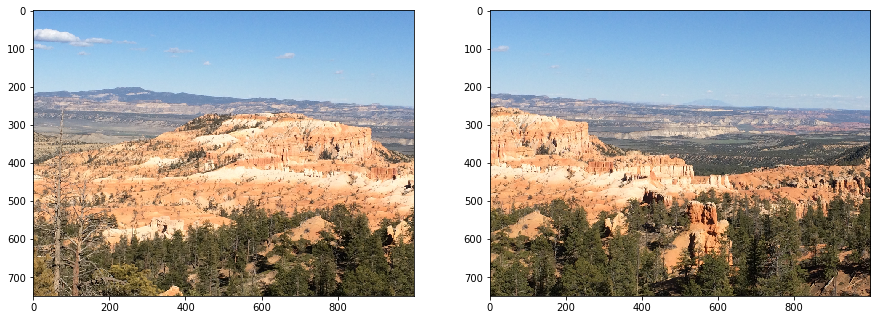

In [2]:
plt.subplots(1, 2, figsize=(15,12))
plt.subplot(121), plt.imshow(plt.imread('./panorama/mountain2_left.png'))
plt.subplot(122), plt.imshow(plt.imread('./panorama/mountain2_right.png'))

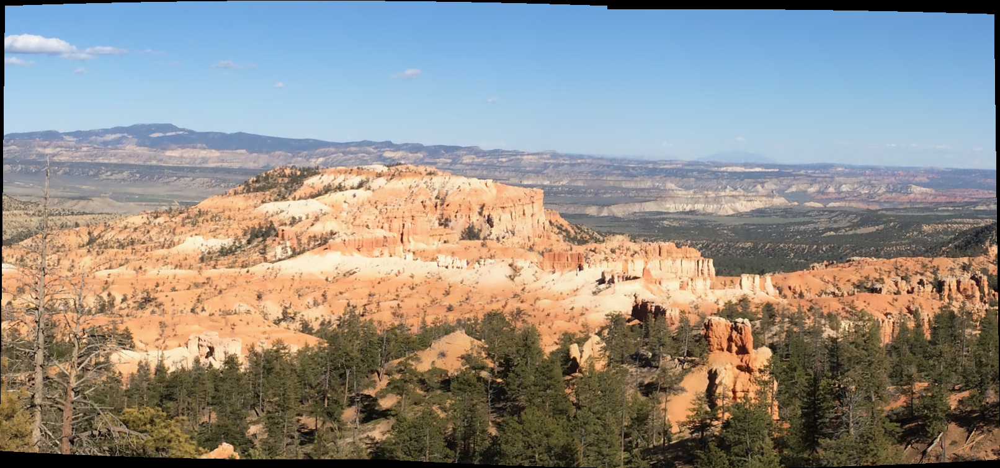

In [8]:
imageA = cv2.imread('./panorama/mountain2_left.png')
imageB = cv2.imread('./panorama/mountain2_right.png')

stitcher = cv2.createStitcher(False)
result = stitcher.stitch((imageA, imageB))
cv2.imwrite('mountain2.png', result[1])
Image('mountain2.png')

In [10]:
def better_stitching(stitched):
    stitched = cv2.copyMakeBorder(stitched, 10, 10, 10, 10,
        cv2.BORDER_CONSTANT, (0, 0, 0))

    # convert the stitched image to grayscale and threshold it
    # such that all pixels greater than zero are set to 255
    # (foreground) while all others remain 0 (background)
    gray = cv2.cvtColor(stitched, cv2.COLOR_BGR2GRAY)
    thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)[1]
    
    
    # find all external contours in the threshold image then find
    # the *largest* contour which will be the contour/outline of
    # the stitched image
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL,
        cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)

    # allocate memory for the mask which will contain the
    # rectangular bounding box of the stitched image region
    mask = np.zeros(thresh.shape, dtype="uint8")
    (x, y, w, h) = cv2.boundingRect(c)
    cv2.rectangle(mask, (x, y), (x + w, y + h), 255, -1)
    
    # create two copies of the mask: one to serve as our actual
    # minimum rectangular region and another to serve as a counter
    # for how many pixels need to be removed to form the minimum
    # rectangular region
    minRect = mask.copy()
    sub = mask.copy()

    # keep looping until there are no non-zero pixels left in the
    # subtracted image
    while cv2.countNonZero(sub) > 0:
        # erode the minimum rectangular mask and then subtract
        # the thresholded image from the minimum rectangular mask
        # so we can count if there are any non-zero pixels left
        minRect = cv2.erode(minRect, None)
        sub = cv2.subtract(minRect, thresh)
        
    # find contours in the minimum rectangular mask and then
    # extract the bounding box (x, y)-coordinates
    cnts = cv2.findContours(minRect.copy(), cv2.RETR_EXTERNAL,
        cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    (x, y, w, h) = cv2.boundingRect(c)

    # use the bounding box coordinates to extract the our final
    # stitched image
    stitched = stitched[y:y + h, x:x + w]
    
    return stitched

In [11]:
stitched = better_stitching(result[1])

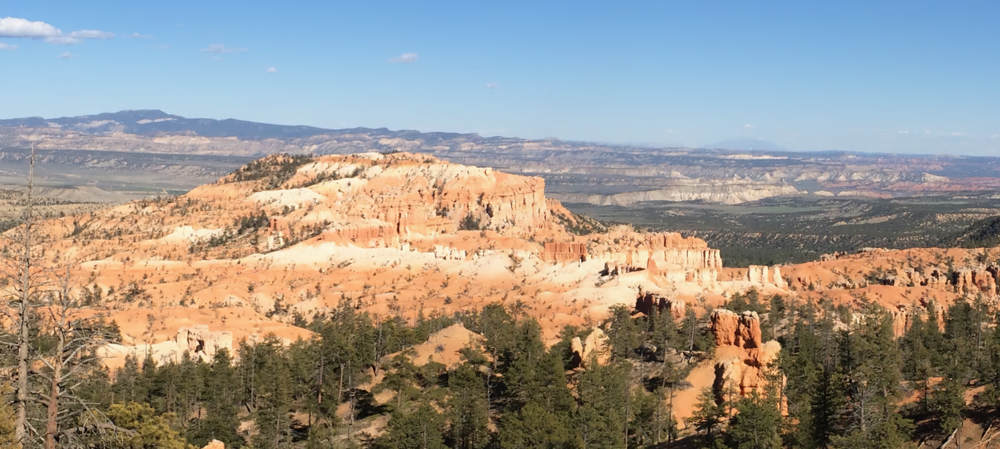

In [12]:
cv2.imwrite('mountain2_final.png', stitched)
Image('mountain2_final.png')

(<matplotlib.axes._subplots.AxesSubplot at 0x7f21dcbca5f8>,
 <matplotlib.image.AxesImage at 0x7f21dcb2cb00>)

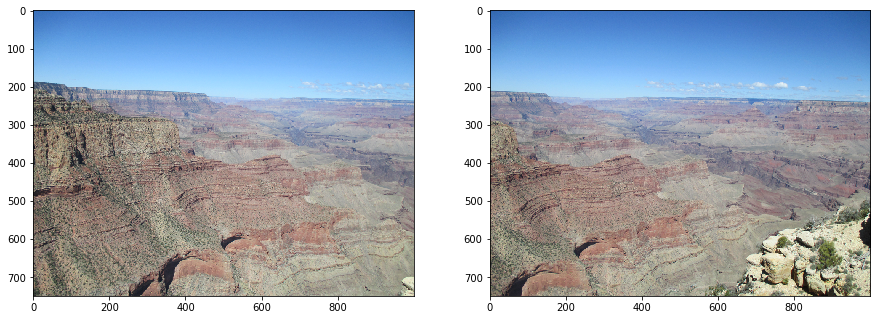

In [13]:
plt.subplots(1, 2, figsize=(15,12))
plt.subplot(121), plt.imshow(plt.imread('./panorama/mountain5_left.png'))
plt.subplot(122), plt.imshow(plt.imread('./panorama/mountain5_right.png'))

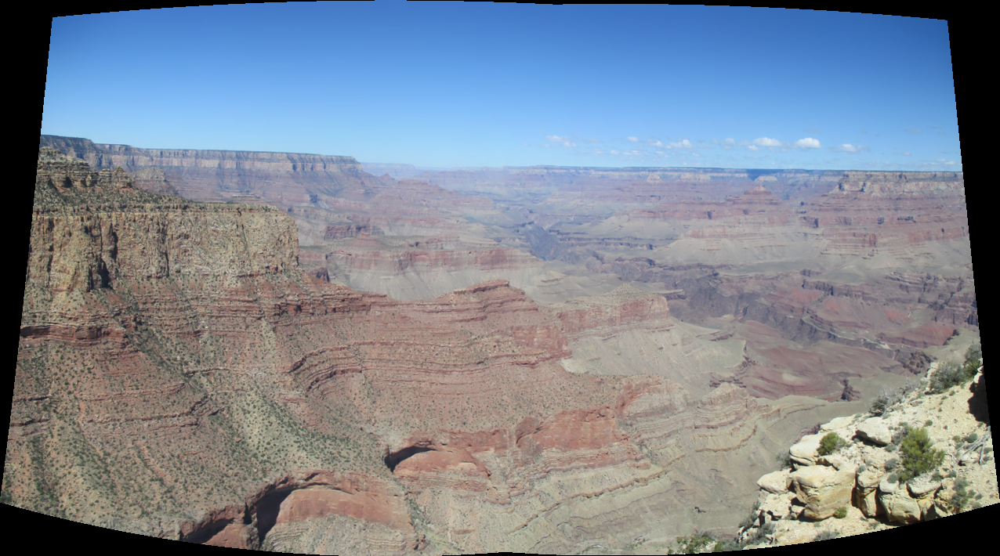

In [14]:
imageA = cv2.imread('./panorama/mountain5_left.png')
imageB = cv2.imread('./panorama/mountain5_right.png')

stitcher = cv2.createStitcher(False)
result = stitcher.stitch((imageA, imageB))
cv2.imwrite('mountain5.png', result[1])
Image('mountain5.png')

In [15]:
stitched = better_stitching(result[1])

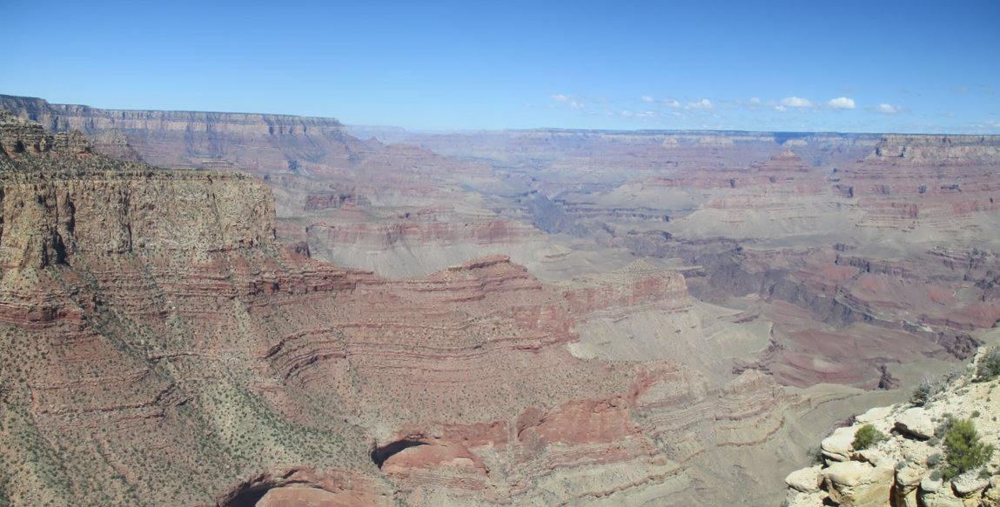

In [16]:
cv2.imwrite('mountain5_final.png', stitched)
Image('mountain5_final.png')

(<matplotlib.axes._subplots.AxesSubplot at 0x7f21dc9e2080>,
 <matplotlib.image.AxesImage at 0x7f21dca108d0>)

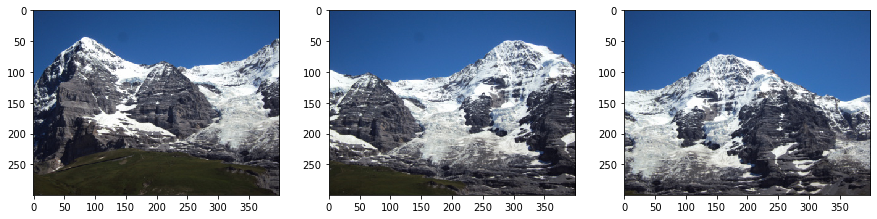

In [17]:
plt.subplots(1, 3, figsize=(15,12))
plt.subplot(131), plt.imshow(plt.imread('./panorama/1Hill.JPG'))
plt.subplot(132), plt.imshow(plt.imread('./panorama/2Hill.JPG'))
plt.subplot(133), plt.imshow(plt.imread('./panorama/3Hill.JPG'))

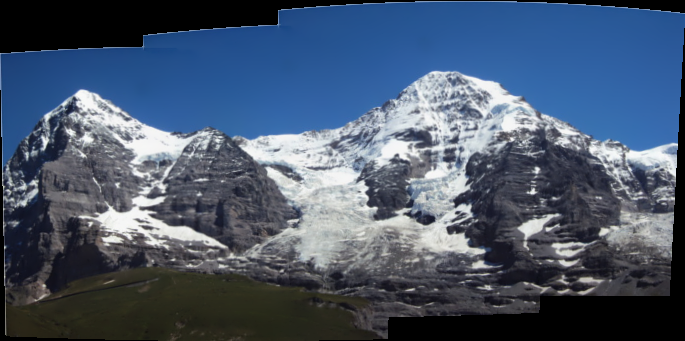

In [18]:
imageA = cv2.imread('./panorama/1Hill.JPG')
imageB = cv2.imread('./panorama/2Hill.JPG')
imageC = cv2.imread('./panorama/3Hill.JPG')

stitcher = cv2.createStitcher(False)
result = stitcher.stitch((imageA, imageB,imageC))
cv2.imwrite('Hill.png', result[1])
Image('Hill.png')

In [19]:
stitched = better_stitching(result[1])

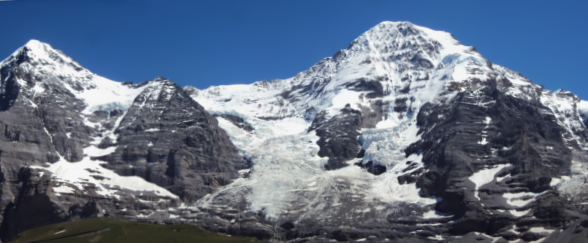

In [20]:
cv2.imwrite('Hill_final.png',stitched)
Image('Hill_final.png')

(<matplotlib.axes._subplots.AxesSubplot at 0x7f21dc7c6a58>,
 <matplotlib.image.AxesImage at 0x7f21dc7356d8>)

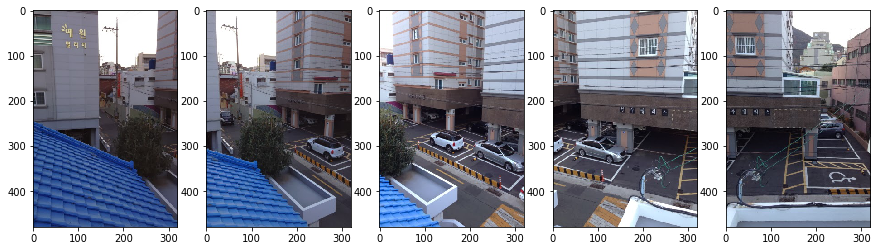

In [21]:
plt.subplots(1, 5, figsize=(15,12))
plt.subplot(151), plt.imshow(plt.imread('./panorama/outside1.jpg'))
plt.subplot(152), plt.imshow(plt.imread('./panorama/outside2.jpg'))
plt.subplot(153), plt.imshow(plt.imread('./panorama/outside3.jpg'))
plt.subplot(154), plt.imshow(plt.imread('./panorama/outside4.jpg'))
plt.subplot(155), plt.imshow(plt.imread('./panorama/outside5.jpg'))

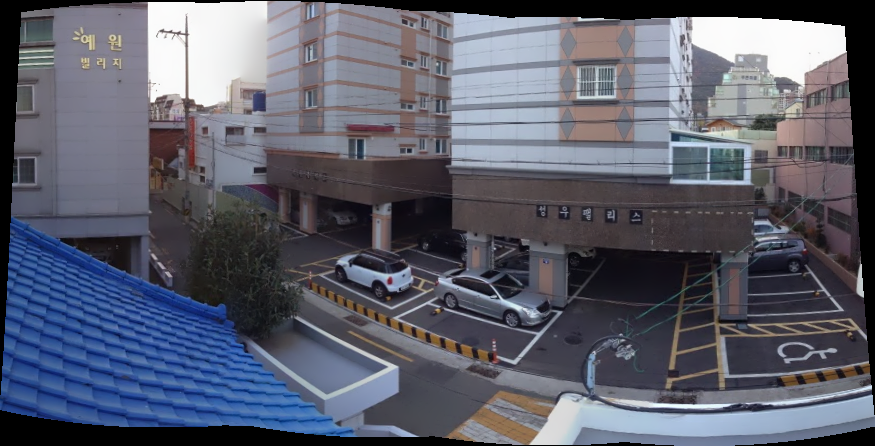

In [22]:
image1 = cv2.imread('./panorama/outside1.jpg')
image2 = cv2.imread('./panorama/outside2.jpg')
image3 = cv2.imread('./panorama/outside3.jpg')
image4 = cv2.imread('./panorama/outside4.jpg')
image5 = cv2.imread('./panorama/outside5.jpg')

stitcher = cv2.createStitcher(False)
result = stitcher.stitch((image1, image2,image3,image4,image5))
cv2.imwrite('outside.png', result[1])
Image('outside.png')

In [23]:
stitched = better_stitching(result[1])

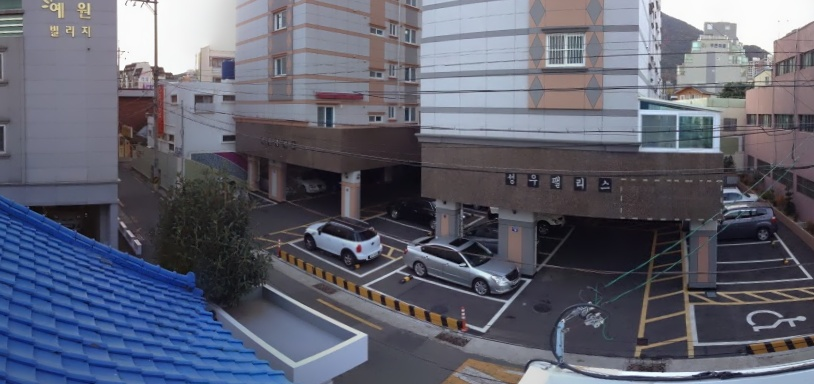

In [24]:
cv2.imwrite('outside_final.jpg',stitched)
Image('outside_final.jpg')

(<matplotlib.axes._subplots.AxesSubplot at 0x7f21dc4ba630>,
 <matplotlib.image.AxesImage at 0x7f21dc426a90>)

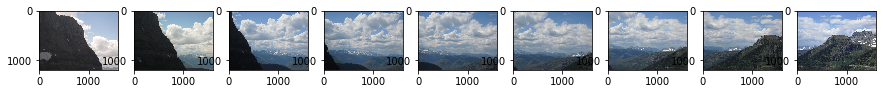

In [25]:
plt.subplots(1, 9, figsize=(15,12))
plt.subplot(191), plt.imshow(plt.imread('./panorama/CIMG1.JPG'))
plt.subplot(192), plt.imshow(plt.imread('./panorama/CIMG2.JPG'))
plt.subplot(193), plt.imshow(plt.imread('./panorama/CIMG3.JPG'))
plt.subplot(194), plt.imshow(plt.imread('./panorama/CIMG4.JPG'))
plt.subplot(195), plt.imshow(plt.imread('./panorama/CIMG5.JPG'))
plt.subplot(196), plt.imshow(plt.imread('./panorama/CIMG6.JPG'))
plt.subplot(197), plt.imshow(plt.imread('./panorama/CIMG7.JPG'))
plt.subplot(198), plt.imshow(plt.imread('./panorama/CIMG8.JPG'))
plt.subplot(199), plt.imshow(plt.imread('./panorama/CIMG9.JPG'))

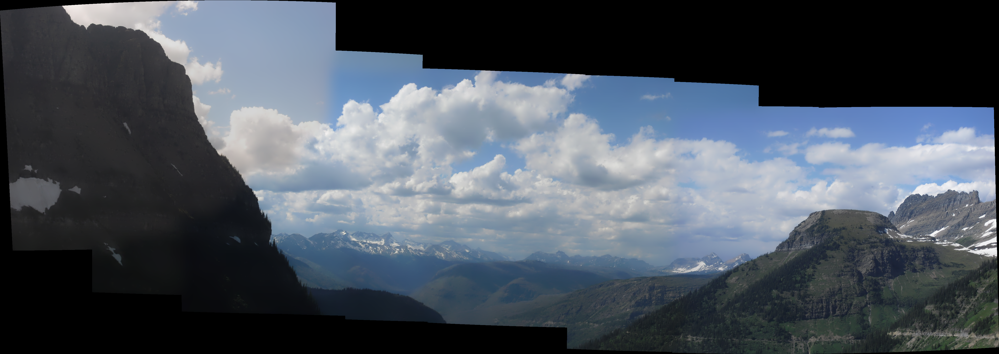

In [26]:
image1 = cv2.imread('./panorama/CIMG1.JPG')
image2 = cv2.imread('./panorama/CIMG2.JPG')
image3 = cv2.imread('./panorama/CIMG3.JPG')
image4 = cv2.imread('./panorama/CIMG4.JPG')
image5 = cv2.imread('./panorama/CIMG5.JPG')
image6 = cv2.imread('./panorama/CIMG6.JPG')
image7 = cv2.imread('./panorama/CIMG7.JPG')
image8 = cv2.imread('./panorama/CIMG8.JPG')
image9 = cv2.imread('./panorama/CIMG9.JPG')


stitcher = cv2.createStitcher(False)
result = stitcher.stitch((image1, image2,image3,image4,image5,image6,image8,image9))
cv2.imwrite('CIMG.png', result[1])
Image('CIMG.png')

# 2 

## with opencv

(<matplotlib.axes._subplots.AxesSubplot at 0x7f21dc385518>,
 <matplotlib.image.AxesImage at 0x7f21dc2ecb70>)

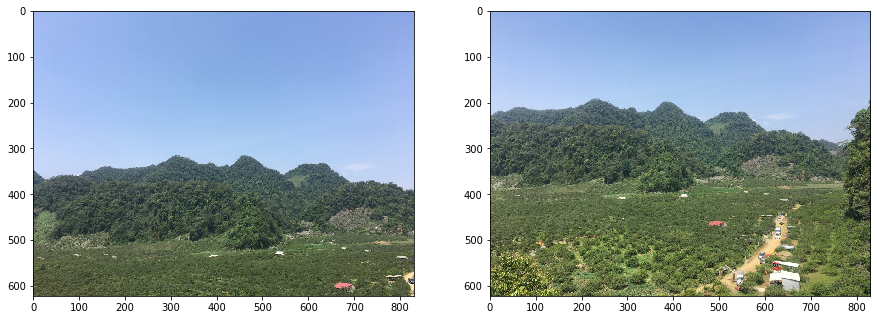

In [27]:
plt.subplots(1, 2, figsize=(15,12))
plt.subplot(121), plt.imshow(plt.imread('1.JPG'))
plt.subplot(122), plt.imshow(plt.imread('2.JPG'))

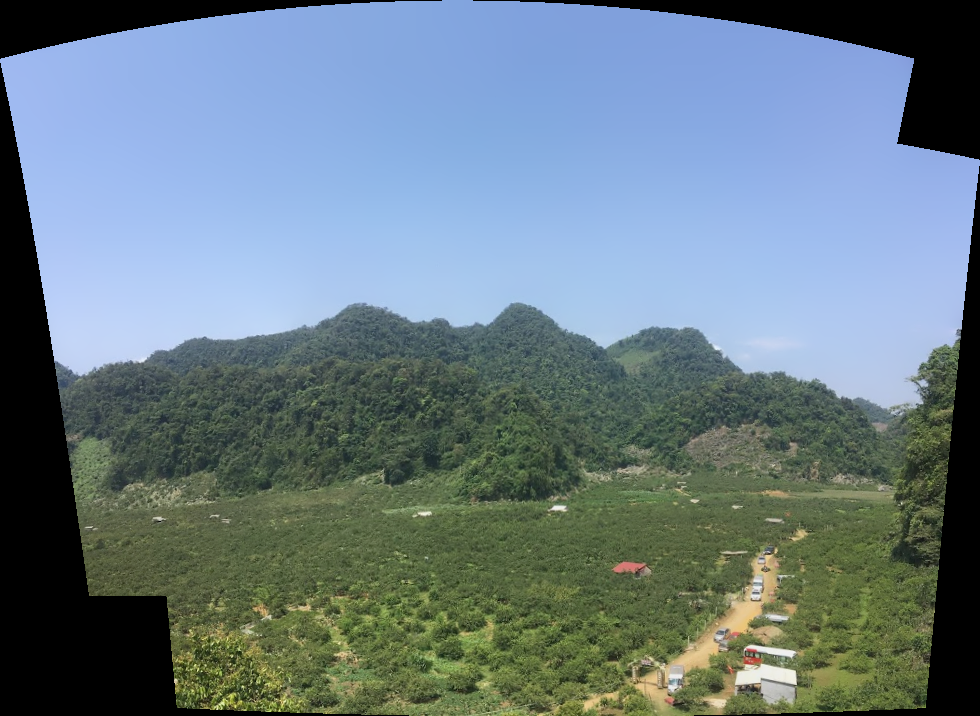

In [28]:
imageA = cv2.imread('1.JPG')
imageB = cv2.imread('2.JPG')

stitcher = cv2.createStitcher(False)
result = stitcher.stitch((imageA, imageB))
cv2.imwrite('final_opencv.png', result[1])
Image('final_opencv.png')

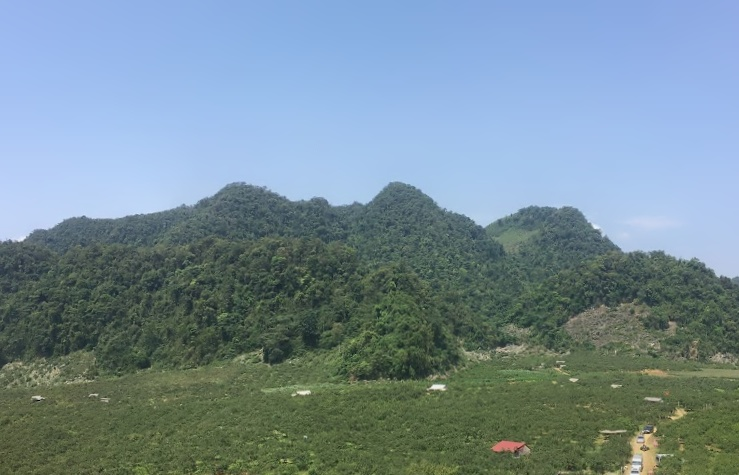

In [29]:
stitched = better_stitching(result[1])
cv2.imwrite('final_cv2.jpg',stitched)
Image('final_cv2.jpg')

## 

In [85]:
def detectAndDescribe(image):
    # convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # detect and extract features from the image
    descriptor = cv2.xfeatures2d.SIFT_create()
    (kps, features) = descriptor.detectAndCompute(image, None)

    # convert the keypoints from KeyPoint objects to NumPy arrays
    kps = np.float32([kp.pt for kp in kps])

    # return a tuple of keypoints and features
    return (kps, features)

In [31]:
def ransac(keypoints1, keypoints2, matches, n_iters=200, threshold=20):
    """
    Use RANSAC to find a robust affine transformation

        1. Select random set of matches
        2. Compute affine transformation matrix
        3. Compute inliers
        4. Keep the largest set of inliers
        5. Re-compute least-squares estimate on all of the inliers

    Args:
        keypoints1: M1 x 2 matrix, each row is a point
        keypoints2: M2 x 2 matrix, each row is a point
        matches: N x 2 matrix, each row represents a match
            [index of keypoint1, index of keypoint 2]
        n_iters: the number of iterations RANSAC will run
        threshold: the number of threshold to find inliers

    Returns:
        H: a robust estimation of affine transformation from keypoints2 to
        keypoints 1
    """
    pad = lambda x: np.hstack([x, np.ones((x.shape[0], 1))])

    N = matches.shape[0]
    n_samples = int(N * 0.2)

    matched1 = pad(keypoints1[matches[:,0]])
    matched2 = pad(keypoints2[matches[:,1]])

    max_inliers = np.zeros(N)
    n_inliers = 0

    # RANSAC iteration start
    ### YOUR CODE HERE
    for i in range(n_iters):
        temp_max = np.zeros(N, dtype=np.int32)
        temp_n = 0
        idx = np.random.choice(N, n_samples, replace=False)
        p1 = matched1[idx, :]
        p2 = matched2[idx, :]
        H = np.linalg.lstsq(p2, p1, rcond=None)[0]
        H[:, 2] = np.array([0, 0, 1])
        temp_max = np.linalg.norm(matched2.dot(H) - matched1, axis=1) ** 2 < threshold
        temp_n = np.sum(temp_max)
        if temp_n > n_inliers:
            max_inliers = temp_max.copy()
            n_inliers = temp_n
    H = np.linalg.lstsq(matched2[max_inliers], matched1[max_inliers], rcond=None)[0]
    H[:, 2] = np.array([0, 0, 1])
    ### END YOUR CODE
    return H, matches[max_inliers]

In [32]:
def matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh):
    # compute the raw matches and initialize the list of actual
    # matches
    matcher = cv2.DescriptorMatcher_create("BruteForce")
    rawMatches = matcher.knnMatch(featuresA, featuresB, 2)
    matches = []

    # loop over the raw matches
    for m in rawMatches:
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if len(m) == 2 and m[0].distance < m[1].distance * ratio:
            matches.append((m[0].trainIdx, m[0].queryIdx))

    # computing a homography requires at least 4 matches
    if len(matches) > 4:
        # construct the two sets of points
        ptsA = np.float32([kpsA[i] for (_, i) in matches])
        ptsB = np.float32([kpsB[i] for (i, _) in matches])

        # compute the homography between the two sets of points
        (H, status) = cv2.findHomography(ptsA, ptsB, cv2.RANSAC,
            reprojThresh)

        # return the matches along with the homograpy matrix
        # and status of each matched point
        return (matches, H, status)

    # otherwise, no homograpy could be computed
    return None

In [33]:
def drawMatches(imageA, imageB, kpsA, kpsB, matches, status):
    # initialize the output visualization image
    (hA, wA) = imageA.shape[:2]
    (hB, wB) = imageB.shape[:2]
    vis = np.zeros((max(hA, hB), wA + wB, 3), dtype="uint8")
    vis[0:hA, 0:wA] = imageA
    vis[0:hB, wA:] = imageB

    # loop over the matches
    for ((trainIdx, queryIdx), s) in zip(matches, status):
        # only process the match if the keypoint was successfully
        # matched
        if s == 1:
            # draw the match
            ptA = (int(kpsA[queryIdx][0]), int(kpsA[queryIdx][1]))
            ptB = (int(kpsB[trainIdx][0]) + wA, int(kpsB[trainIdx][1]))
            cv2.line(vis, ptA, ptB, (0, 255, 0), 1)

    # return the visualization
    return vis

In [101]:
def copyOver(source, destination):
    result_grey = cv2.cvtColor(source, cv2.COLOR_BGR2GRAY)
    ret, mask = cv2.threshold(result_grey, 10, 255, cv2.THRESH_BINARY)
    mask_inv = cv2.bitwise_not(mask)
    roi = cv2.bitwise_and(source, source, mask=mask)
    im2 = cv2.bitwise_and(destination, destination, mask=mask_inv)
    result = cv2.add(im2, roi)
    return result

In [111]:
def stitch(images, ratio=0.75, reprojThresh=4.0, showMatches=False):
    # unpack the images, then detect keypoints and extract
    # local invariant descriptors from them
    (imageB, imageA) = images
    (kpsA, featuresA) = detectAndDescribe(imageA)
    (kpsB, featuresB) = detectAndDescribe(imageB)

    # match features between the two images
    M = matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh)

    # if the match is None, then there aren't enough matched
    # keypoints to create a panorama
    if M is None:
        return None

    # otherwise, apply a perspective warp to stitch the images
    # together
    (matches, H, status) = M
    result = cv2.warpPerspective(imageA, H, (imageA.shape[1] + imageB.shape[1], imageA.shape[0]))
    result[0:imageB.shape[0], 0:imageB.shape[1]] = imageB
    
    
#     warpedImageB = cv2.warpPerspective(imageB, H, (imageA.shape[1], imageA.shape[0]))
#     result = copyOver(imageA, warpedImageB)
    # check to see if the keypoint matches should be visualized
    if showMatches:
        vis = drawMatches(imageA, imageB, kpsA, kpsB, matches, status)

        # return a tuple of the stitched image and the
        # visualization
        return (result, vis)

    # return the stitched image
    return result

(622, 830, 3) (622, 830, 3)


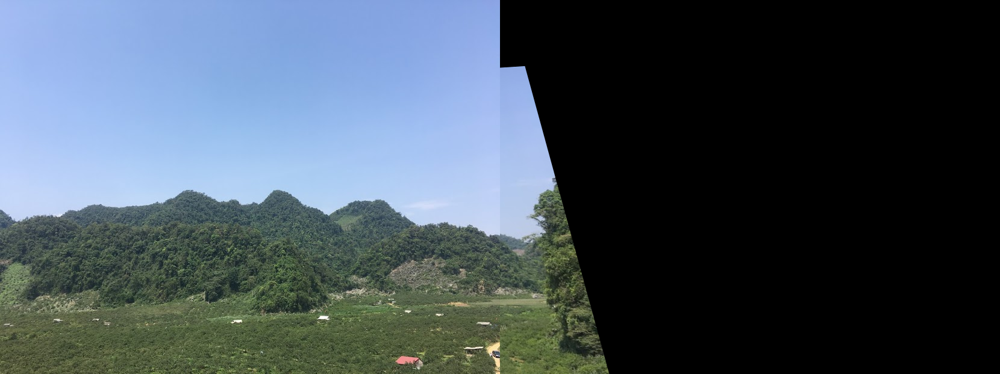

In [112]:
imageA = cv2.imread('1.JPG')
imageB = cv2.imread('2.JPG')
print(imageA.shape,imageB.shape)
(result, vis) = stitch([imageA, imageB], showMatches=True)

cv2.imwrite('final_normal.png', result)
Image('final_normal.png')

So sánh kết quả: Như đã thấy thì opencv đã hoạt động tốt hơn hàm viết lại bằng tay (ghép đúng, k bị mờ phân cách giữa 2 ảnh)

# 3

(<matplotlib.axes._subplots.AxesSubplot at 0x7f21dc9877b8>,
 <matplotlib.image.AxesImage at 0x7f21dc5506a0>)

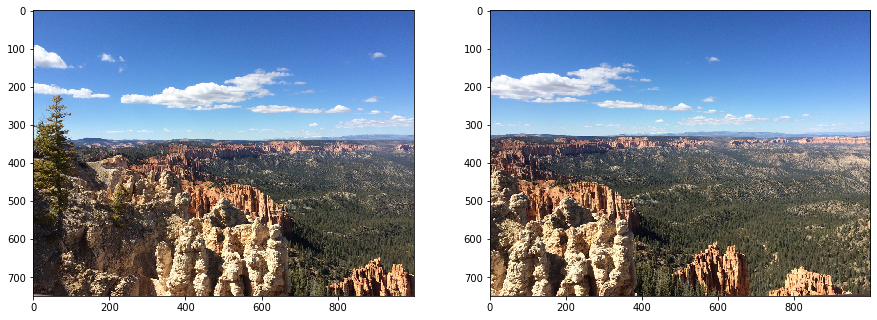

In [39]:
plt.subplots(1, 2, figsize=(15,12))
plt.subplot(121), plt.imshow(plt.imread('./panorama/mountain1_left.png'))
plt.subplot(122), plt.imshow(plt.imread('./panorama/mountain1_right.png'))

In [110]:
imageA = cv2.imread('./panorama/mountain1_left.png')
imageB = cv2.imread('./panorama/mountain1_right.png')
print(imageA.shape,imageB.shape)
# stitch the images together to create a panorama
(result, vis) = stitch([imageA, imageB], showMatches=True)

(750, 1000, 3) (750, 1000, 3)
[[ 6.38345097e-01  1.18565592e-02  3.29982460e+02]
 [-1.31510565e-01  8.87478854e-01  5.14454582e+01]
 [-3.71242745e-04  1.52263966e-05  1.00000000e+00]]


kết quả khi chưa xử  lý

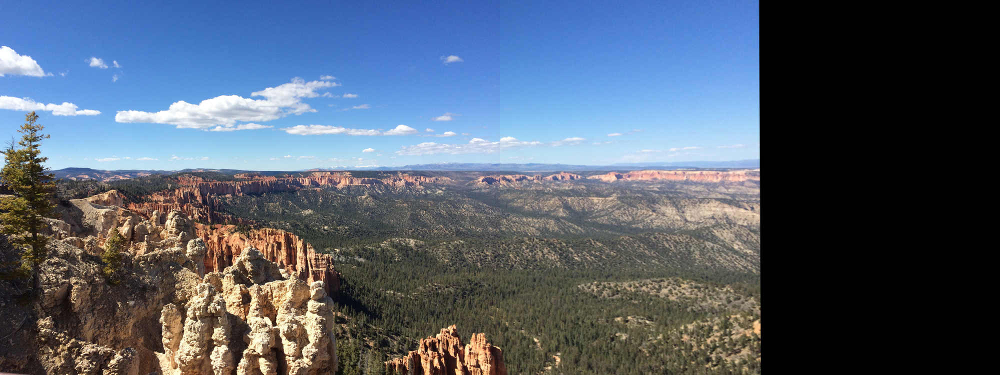

In [90]:
#cv2.imwrite('result_old.png', result)
Image('result_old.png')

kết quả sau khi xử lý ( chi tiết ở hàm copyOver phía trên)

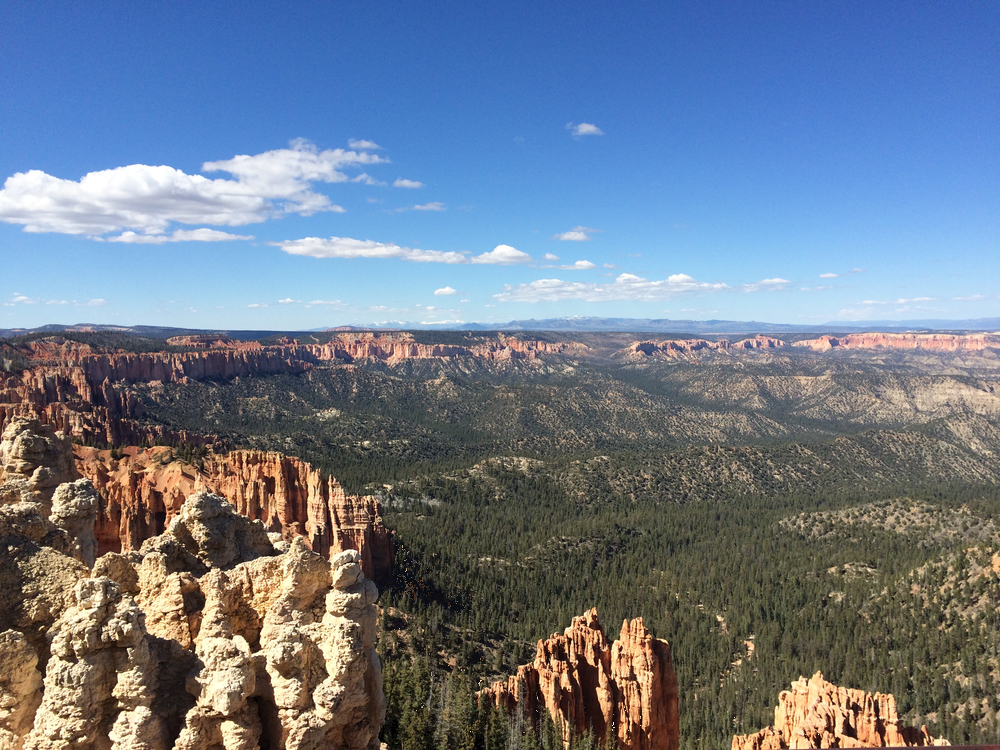

In [107]:
cv2.imwrite('result.png', result)
Image('result.png')

# 4 Stitching Multiple Images

In [43]:
image1 = cv2.imread('./panorama/outside1.jpg')
image2 = cv2.imread('./panorama/outside2.jpg')
image3 = cv2.imread('./panorama/outside3.jpg')
image4 = cv2.imread('./panorama/outside4.jpg')
image5 = cv2.imread('./panorama/outside5.jpg')

images =[image1,image2,image3,image4,image5]
 
(result, vis) = stitch([images[0], images[1]], showMatches=True)
ans = result
for i in range(2,len(images)):
#     (result, vis) = stitch([ans, images[i]], showMatches=True)

(<matplotlib.axes._subplots.AxesSubplot at 0x7f21dc24cb00>,
 <matplotlib.image.AxesImage at 0x7f21dcae2390>)

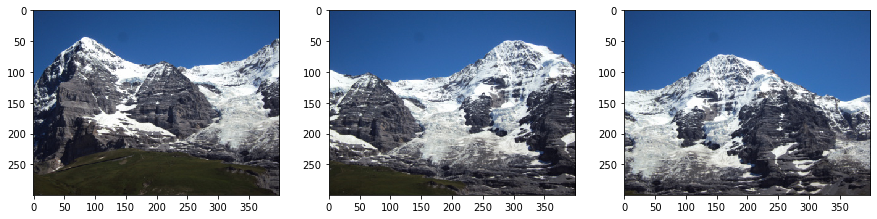

In [64]:
plt.subplots(1, 3, figsize=(15,12))
plt.subplot(131), plt.imshow(plt.imread('./panorama/1Hill.JPG'))
plt.subplot(132), plt.imshow(plt.imread('./panorama/2Hill.JPG'))
plt.subplot(133), plt.imshow(plt.imread('./panorama/3Hill.JPG'))

In [62]:
imageA = cv2.imread('./panorama/1Hill.JPG')
imageB = cv2.imread('./panorama/2Hill.JPG')
imageC = cv2.imread('./panorama/3Hill.JPG')
(result, vis) = stitch([imageA, imageB], showMatches=True)


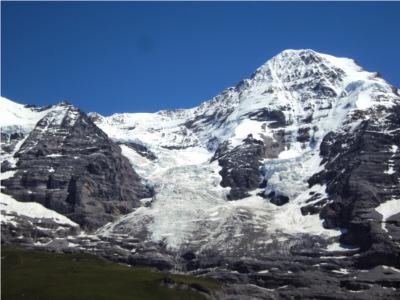

In [63]:
cv2.imwrite('out.png',result)
Image('out.png')

# 5 SURF

In [87]:
def detectAndDescribe(image):
    # convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # detect and extract features from the image
    descriptor = cv2.xfeatures2d.SURF_create()
    (kps, features) = descriptor.detectAndCompute(image, None)

    # convert the keypoints from KeyPoint objects to NumPy arrays
    kps = np.float32([kp.pt for kp in kps])

    # return a tuple of keypoints and features
    return (kps, features)

In [86]:
imageA = cv2.imread('./panorama/mountain1_left.png')
imageB = cv2.imread('./panorama/mountain1_right.png')
print(imageA.shape,imageB.shape)
# stitch the images together to create a panorama

#SIFT
import time 
start_time = time.time()
(result, vis) = stitch([imageA, imageB], showMatches=True)
print('time : ', time.time()-start_time)

(750, 1000, 3) (750, 1000, 3)
time :  2.3825066089630127


In [88]:
#SURF
start_time = time.time()
(result, vis) = stitch([imageA, imageB], showMatches=True)
print('time : ', time.time()-start_time)

time :  2.213149070739746


Từ thực nhiệm trên ta thấy SURF có vẻ chạy nhanh hơn SIFT